Code for **"Blind restoration of a JPEG-compressed image"** and **"Blind image denoising"** figures. Select `fname` below to switch between the two.

- To see overfitting set `num_iter` to a large value.

In [2]:
"""
*Uncomment if running on colab* 
Set Runtime -> Change runtime type -> Under Hardware Accelerator select GPU in Google Colab 
"""
!git clone https://github.com/mitsuhazuki/deep-image-prior
!mv deep-image-prior/* ./

Cloning into 'deep-image-prior'...
remote: Enumerating objects: 446, done.
remote: Counting objects: 100% (157/157), done.
remote: Compressing objects: 100% (115/115), done.
remote: Total 446 (delta 60), reused 110 (delta 40), pack-reused 289
Receiving objects: 100% (446/446), 441.32 MiB | 23.84 MiB/s, done.
Resolving deltas: 100% (215/215), done.
Updating files: 100% (67/67), done.


# Import libs

In [3]:
from __future__ import print_function
import matplotlib.pyplot as plt
%matplotlib inline

import os
#os.environ['CUDA_VISIBLE_DEVICES'] = '3'

import numpy as np
from models import *

import torch
import torch.optim

from skimage.metrics import peak_signal_noise_ratio
from utils.denoising_utils import *

torch.backends.cudnn.enabled = True
torch.backends.cudnn.benchmark =True
dtype = torch.cuda.FloatTensor

imsize =-1
PLOT = True
sigma = 25
sigma_ = sigma/255.

In [4]:
# deJPEG 
# fname = 'data/denoising/snail.jpg'

## denoising
fname = 'data/denoising/barbara.png'

# Load image

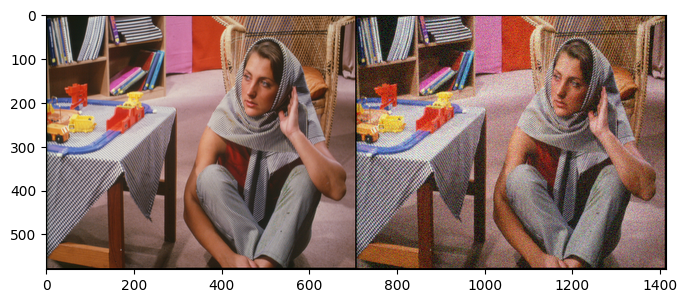

In [5]:
if fname == 'data/denoising/snail.jpg':
    img_noisy_pil = crop_image(get_image(fname, imsize)[0], d=32)
    img_noisy_np = pil_to_np(img_noisy_pil)
    
    # As we don't have ground truth
    img_pil = img_noisy_pil
    img_np = img_noisy_np
    
    if PLOT:
        plot_image_grid([img_np], 4, 5);
        
elif fname == 'data/denoising/F16_GT.png' or fname == 'data/denoising/barbara.png':
    # Add synthetic noise
    img_pil = crop_image(get_image(fname, imsize)[0], d=32)
    img_np = pil_to_np(img_pil)
    
    img_noisy_pil, img_noisy_np = get_noisy_image(img_np, sigma_)
    
    if PLOT:
        plot_image_grid([img_np, img_noisy_np], 4, 6);
else:
    assert False

# Setup

In [6]:
INPUT = 'noise' # 'meshgrid'
pad = 'reflection'
OPT_OVER = 'net' # 'net,input'

reg_noise_std = 1./30. # set to 1./20. for sigma=50
LR = 0.01

OPTIMIZER='adam' # 'LBFGS'
show_every = 100
exp_weight=0.99

if fname == 'data/denoising/snail.jpg':
    num_iter = 2400
    input_depth = 3
    figsize = 5 
    
    net = skip(
                input_depth, 3, 
                num_channels_down = [8, 16, 32, 64, 128], 
                num_channels_up   = [8, 16, 32, 64, 128],
                num_channels_skip = [0, 0, 0, 4, 4], 
                upsample_mode='bilinear',
                need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU')

    net = net.type(dtype)

elif fname == 'data/denoising/F16_GT.png' or fname == 'data/denoising/barbara.png':
    num_iter = 6000 #default was 3000
    input_depth = 32 
    figsize = 6 
    
    
    net = get_net(input_depth, 'skip', pad,
                  skip_n33d=128, 
                  skip_n33u=128, 
                  skip_n11=4, 
                  num_scales=5,
                  upsample_mode='bilinear').type(dtype)

else:
    assert False
    
net_input = get_noise(input_depth, INPUT, (img_pil.size[1], img_pil.size[0])).type(dtype).detach()

# Compute number of parameters
s  = sum([np.prod(list(p.size())) for p in net.parameters()]); 
print ('Number of params: %d' % s)

# Loss
mse = torch.nn.MSELoss().type(dtype)

img_noisy_torch = np_to_torch(img_noisy_np).type(dtype)

Number of params: 2217831


# Optimize

In [7]:
list_out_np = []

Starting optimization with ADAM
Iteration 00000    Loss 0.064718   PSNR_noisy: 11.889730   PSRN_gt: 12.503692 PSNR_gt_sm: 12.503692

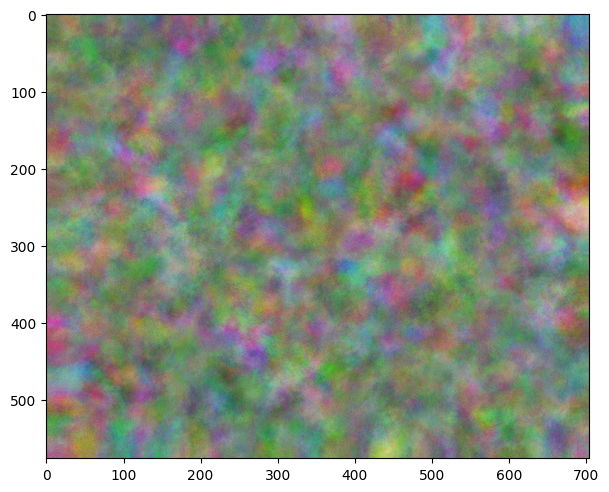

Iteration 00100    Loss 0.023208   PSNR_noisy: 16.343591   PSRN_gt: 18.502438 PSNR_gt_sm: 16.260524

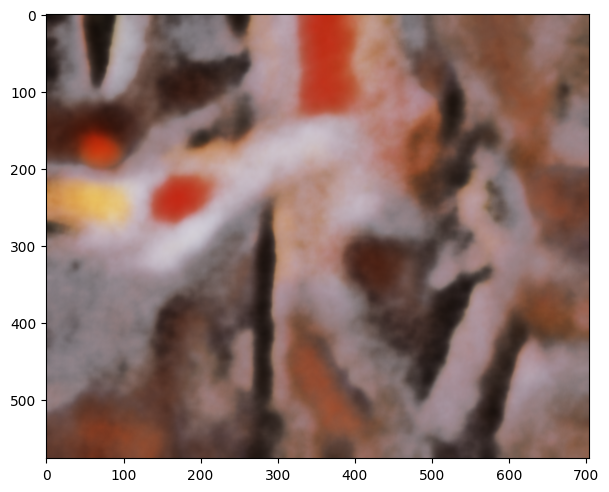

Iteration 00200    Loss 0.018930   PSNR_noisy: 17.228506   PSRN_gt: 20.085326 PSNR_gt_sm: 19.202174

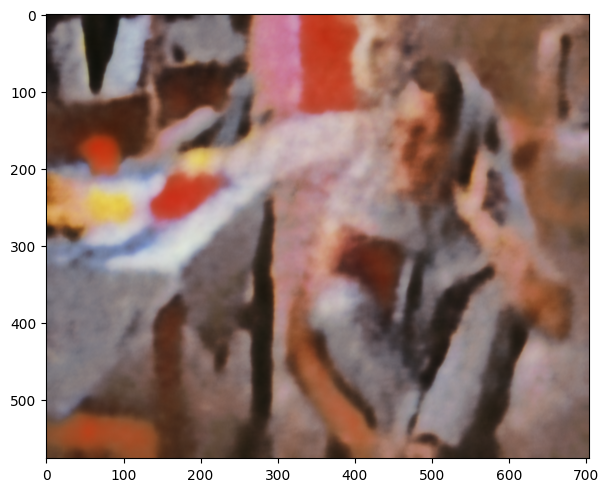

Iteration 00300    Loss 0.017292   PSNR_noisy: 17.621491   PSRN_gt: 20.874265 PSNR_gt_sm: 20.775567

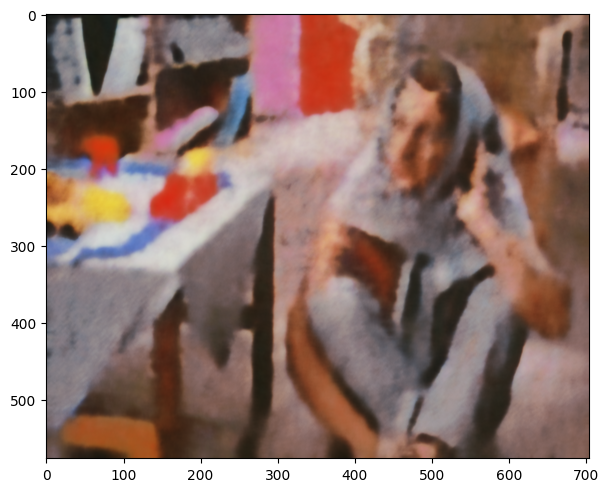

Iteration 00400    Loss 0.016264   PSNR_noisy: 17.887705   PSRN_gt: 21.455413 PSNR_gt_sm: 21.585271

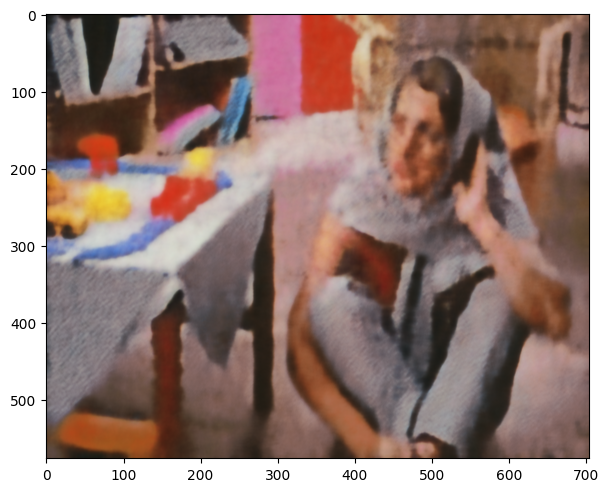

Iteration 00500    Loss 0.015659   PSNR_noisy: 18.052303   PSRN_gt: 21.836941 PSNR_gt_sm: 22.138443

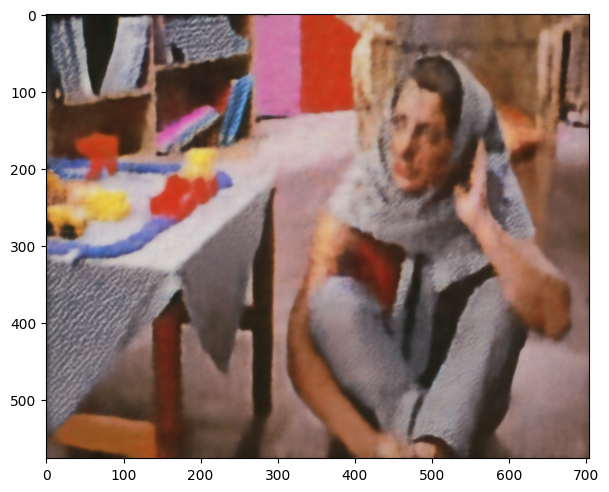

Iteration 00600    Loss 0.014894   PSNR_noisy: 18.269989   PSRN_gt: 22.371799 PSNR_gt_sm: 22.665562

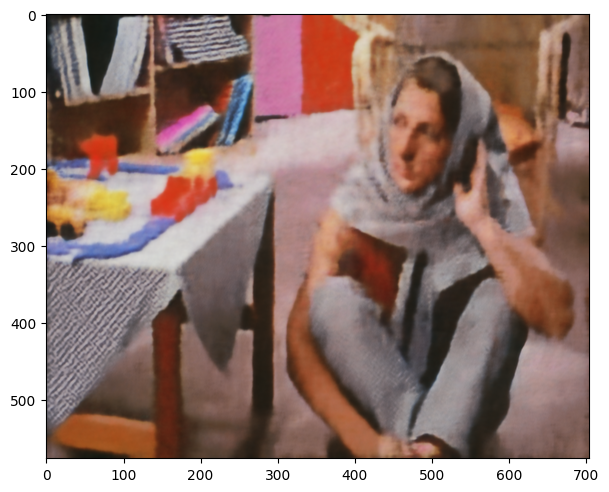

Iteration 00700    Loss 0.014368   PSNR_noisy: 18.425996   PSRN_gt: 22.766656 PSNR_gt_sm: 23.171314

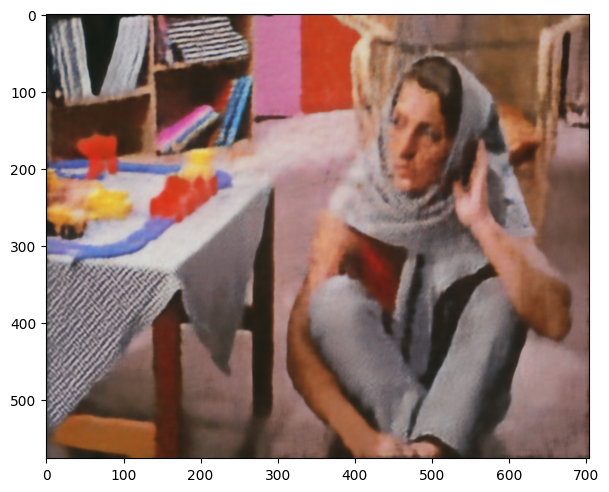

Iteration 00800    Loss 0.013991   PSNR_noisy: 18.541513   PSRN_gt: 23.079674 PSNR_gt_sm: 23.574545

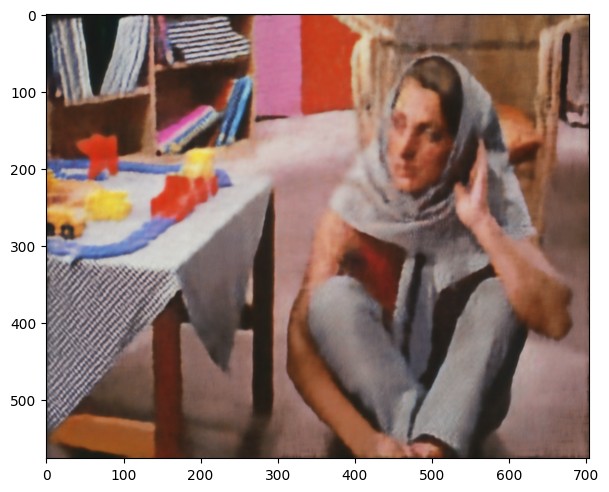

Iteration 00900    Loss 0.013654   PSNR_noisy: 18.647291   PSRN_gt: 23.363267 PSNR_gt_sm: 23.900199

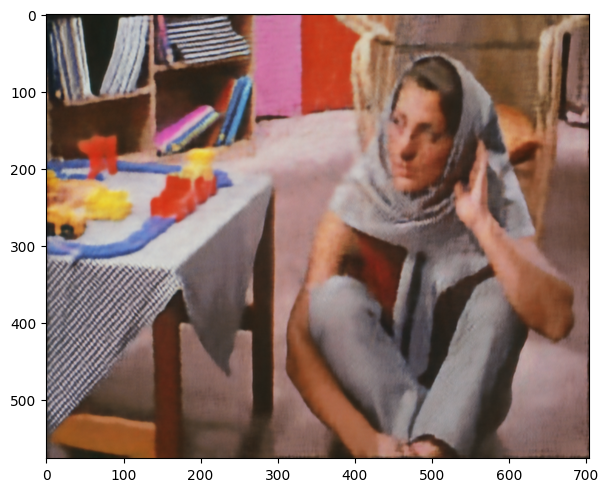

Iteration 01000    Loss 0.013387   PSNR_noisy: 18.733167   PSRN_gt: 23.620035 PSNR_gt_sm: 24.190531

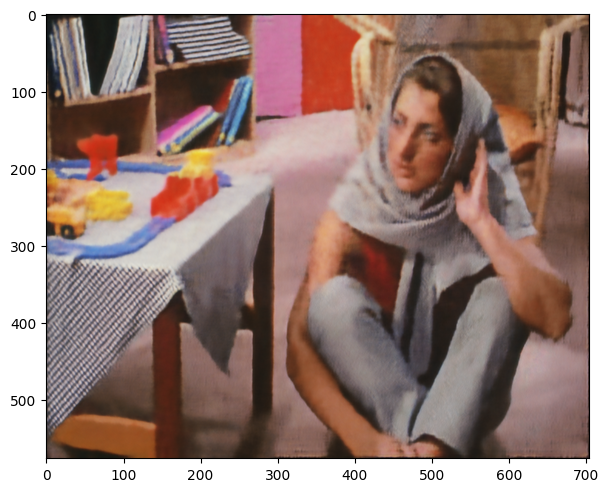

Iteration 01100    Loss 0.013168   PSNR_noisy: 18.804741   PSRN_gt: 23.834538 PSNR_gt_sm: 24.480505

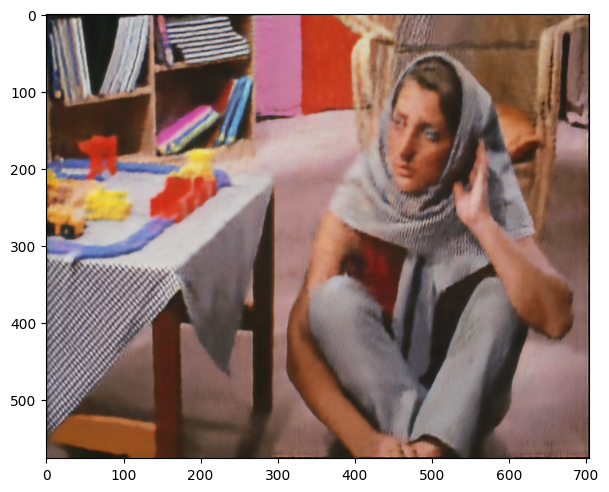

Iteration 01200    Loss 0.012715   PSNR_noisy: 18.956838   PSRN_gt: 24.313303 PSNR_gt_sm: 24.849305

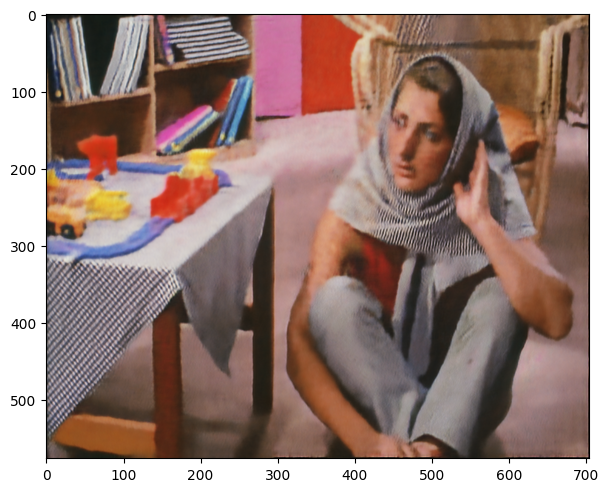

Iteration 01300    Loss 0.012466   PSNR_noisy: 19.042694   PSRN_gt: 24.613101 PSNR_gt_sm: 25.223180

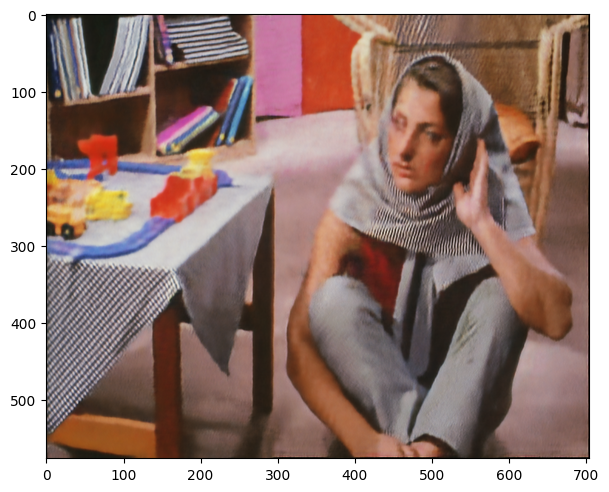

Iteration 01400    Loss 0.012295   PSNR_noisy: 19.102539   PSRN_gt: 24.804343 PSNR_gt_sm: 25.517369

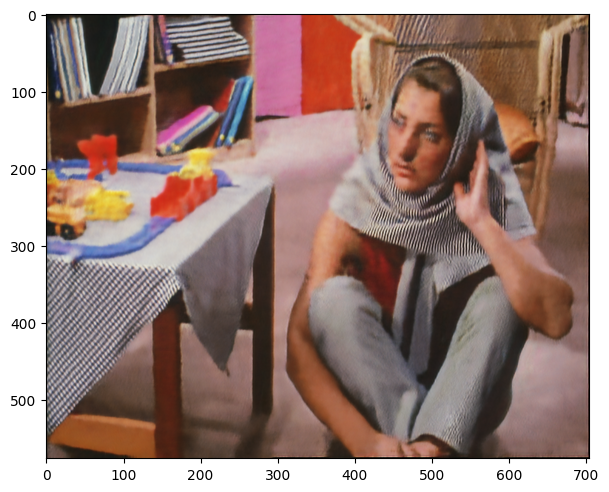

Iteration 01500    Loss 0.012056   PSNR_noisy: 19.187999   PSRN_gt: 25.099357 PSNR_gt_sm: 25.883446

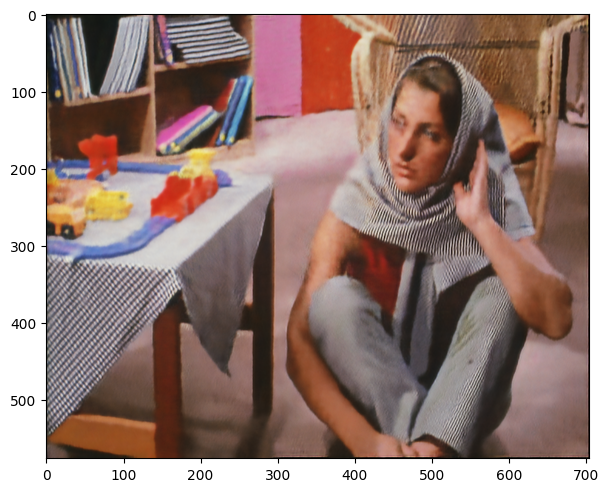

Iteration 01600    Loss 0.011775   PSNR_noisy: 19.290554   PSRN_gt: 25.487983 PSNR_gt_sm: 26.321874

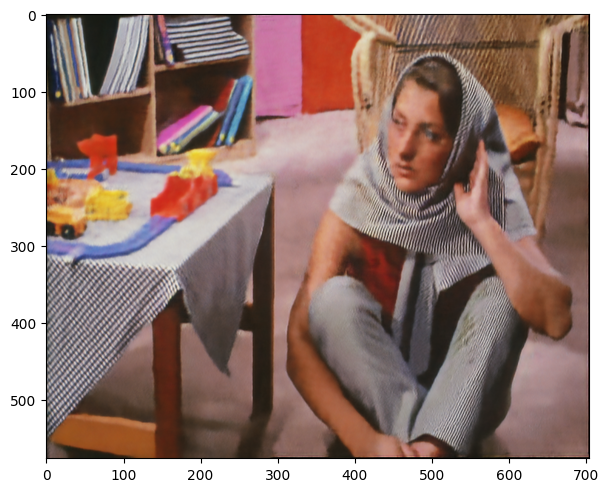

Iteration 01700    Loss 0.011632   PSNR_noisy: 19.343632   PSRN_gt: 25.704353 PSNR_gt_sm: 26.706848

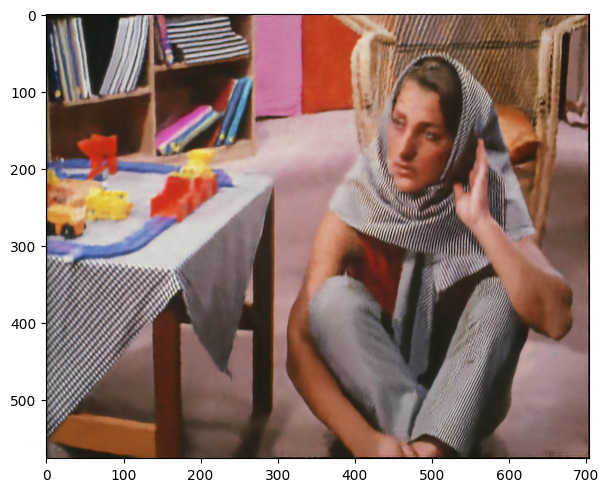

Iteration 01800    Loss 0.011436   PSNR_noisy: 19.417338   PSRN_gt: 25.978478 PSNR_gt_sm: 27.064519

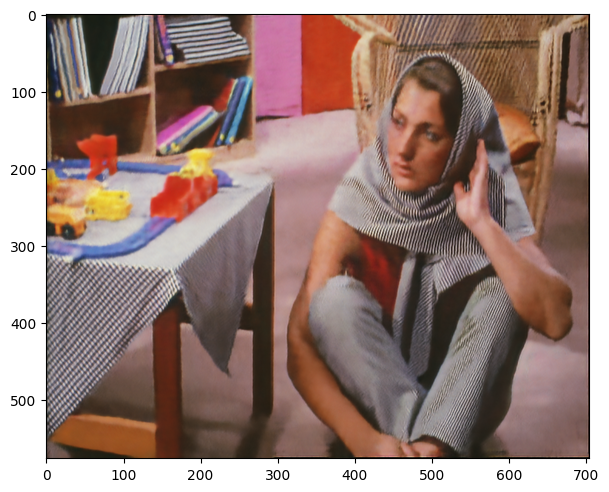

Iteration 01900    Loss 0.011250   PSNR_noisy: 19.488430   PSRN_gt: 26.259397 PSNR_gt_sm: 27.387847

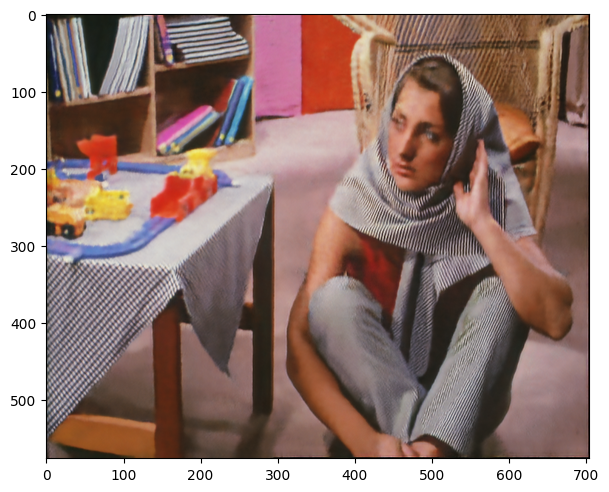

Iteration 02000    Loss 0.011134   PSNR_noisy: 19.533389   PSRN_gt: 26.453919 PSNR_gt_sm: 27.672334

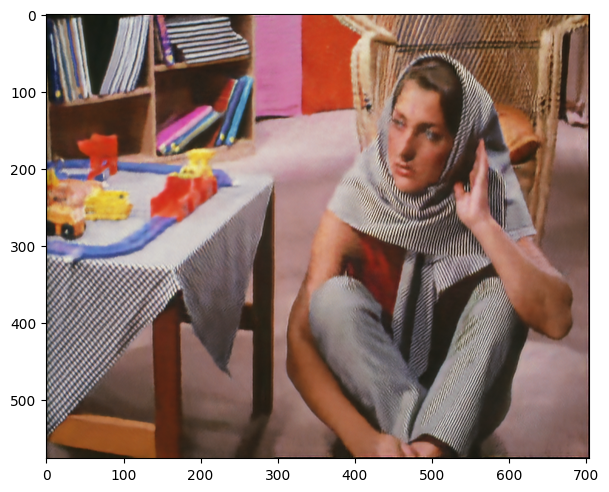

Iteration 02100    Loss 0.011080   PSNR_noisy: 19.554747   PSRN_gt: 26.495789 PSNR_gt_sm: 27.950145

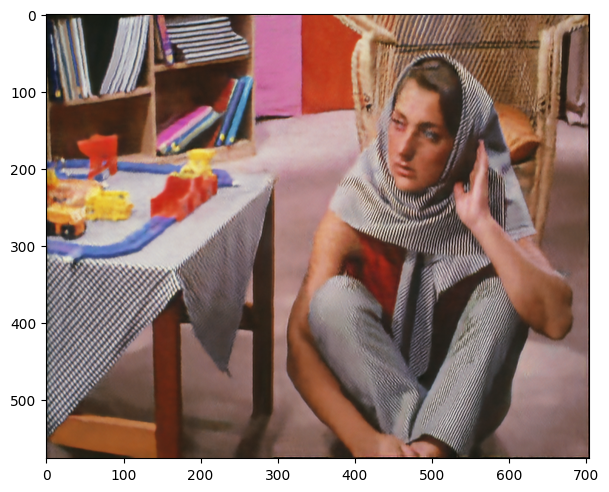

Iteration 02200    Loss 0.010834   PSNR_noisy: 19.652296   PSRN_gt: 26.934329 PSNR_gt_sm: 28.283988

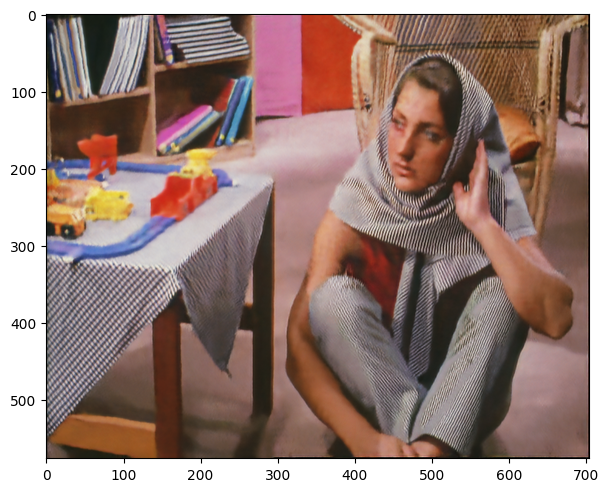

Iteration 02300    Loss 0.010774   PSNR_noisy: 19.676151   PSRN_gt: 27.015736 PSNR_gt_sm: 28.640652

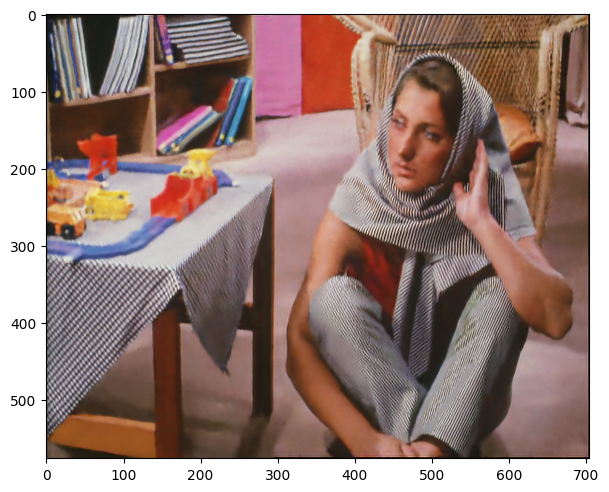

Iteration 02400    Loss 0.010643   PSNR_noisy: 19.729301   PSRN_gt: 27.286028 PSNR_gt_sm: 28.959287

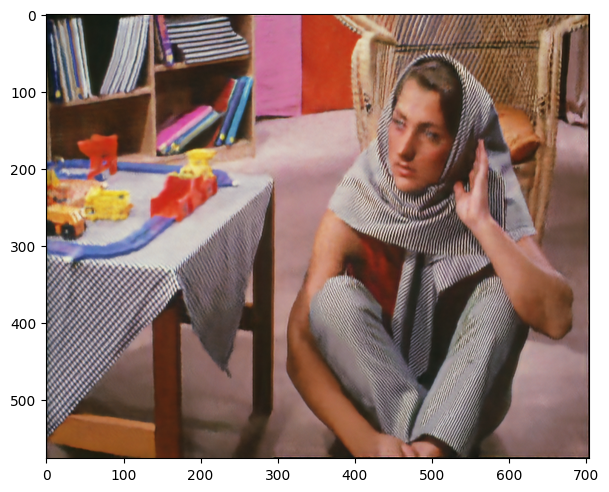

Iteration 02500    Loss 0.010522   PSNR_noisy: 19.779176   PSRN_gt: 27.472950 PSNR_gt_sm: 29.220075

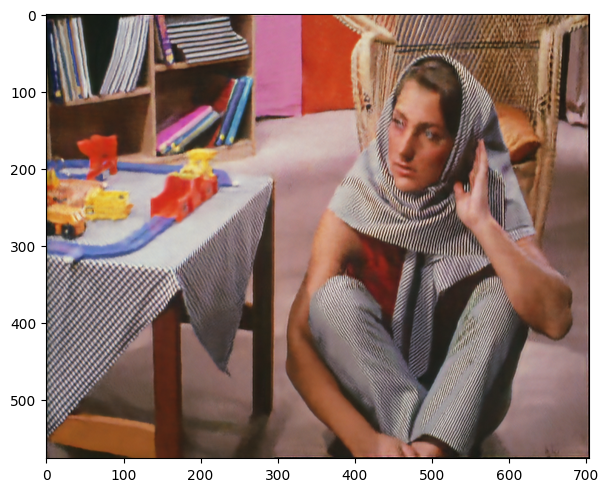

Iteration 02600    Loss 0.010392   PSNR_noisy: 19.833148   PSRN_gt: 27.736010 PSNR_gt_sm: 29.454251

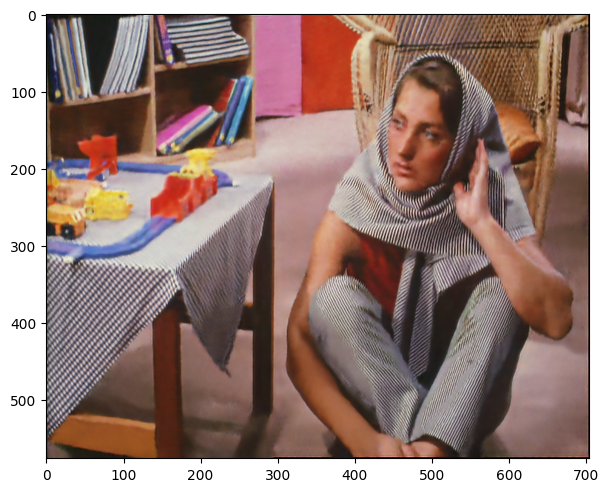

Iteration 02700    Loss 0.010322   PSNR_noisy: 19.862252   PSRN_gt: 27.779239 PSNR_gt_sm: 29.653585

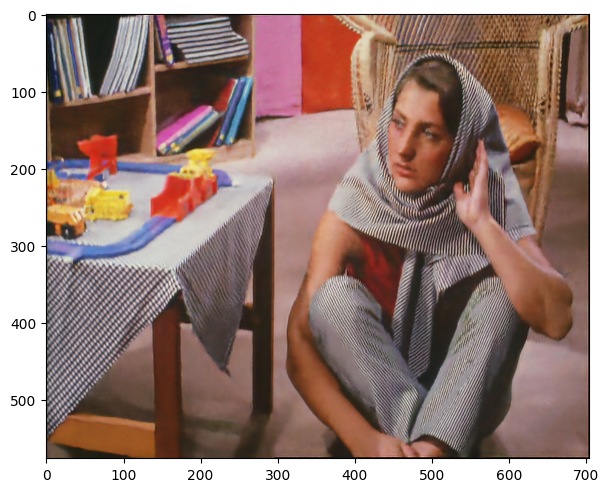

Iteration 02800    Loss 0.010245   PSNR_noisy: 19.895028   PSRN_gt: 27.921565 PSNR_gt_sm: 29.822104

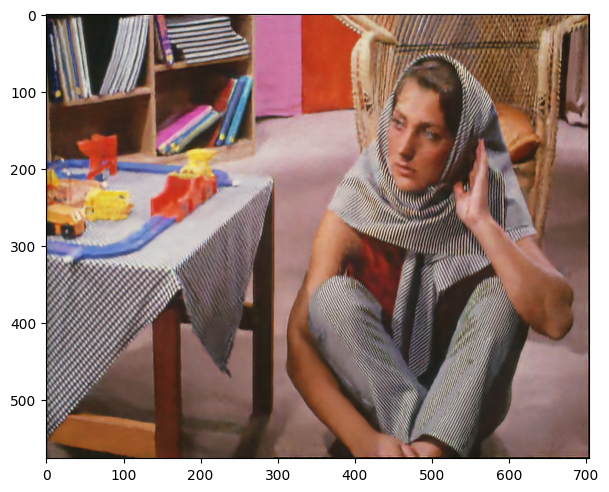

Iteration 02900    Loss 0.010194   PSNR_noisy: 19.916730   PSRN_gt: 27.968835 PSNR_gt_sm: 29.957690

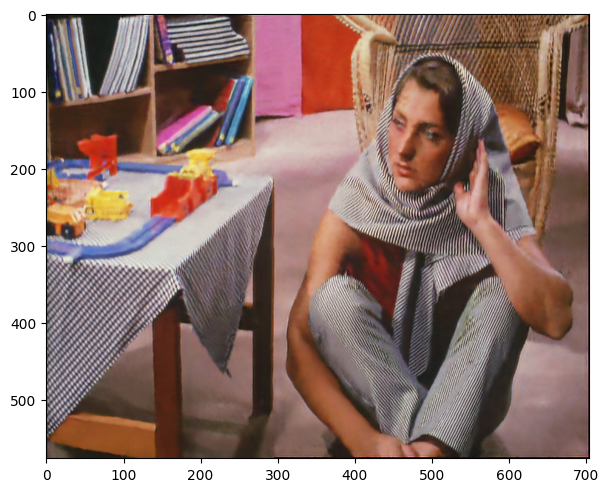

Iteration 03000    Loss 0.010059   PSNR_noisy: 19.974359   PSRN_gt: 28.278985 PSNR_gt_sm: 30.074590

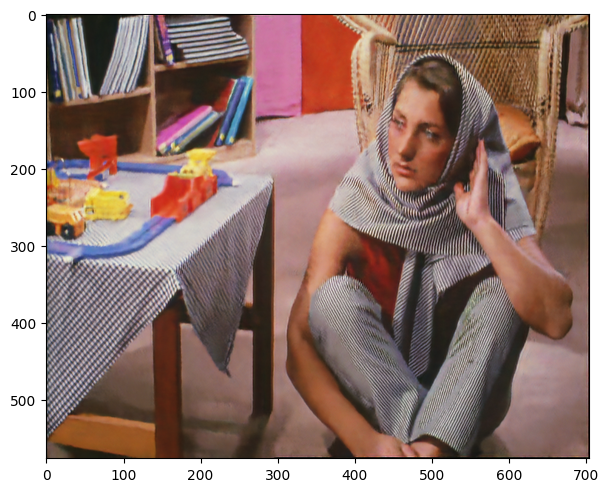

Iteration 03100    Loss 0.010004   PSNR_noisy: 19.998316   PSRN_gt: 28.334324 PSNR_gt_sm: 30.175160

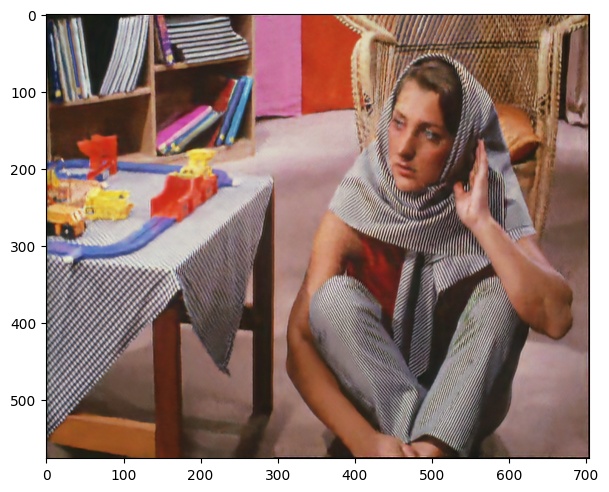

Iteration 03200    Loss 0.009966   PSNR_noisy: 20.014850   PSRN_gt: 28.386008 PSNR_gt_sm: 30.263576

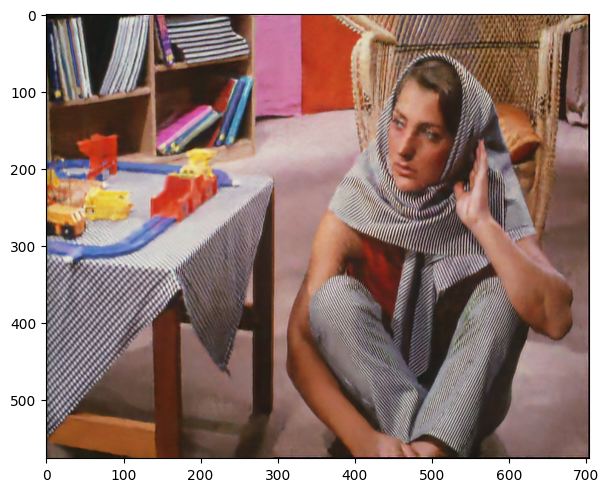

Iteration 03300    Loss 0.009896   PSNR_noisy: 20.045520   PSRN_gt: 28.432699 PSNR_gt_sm: 30.334689

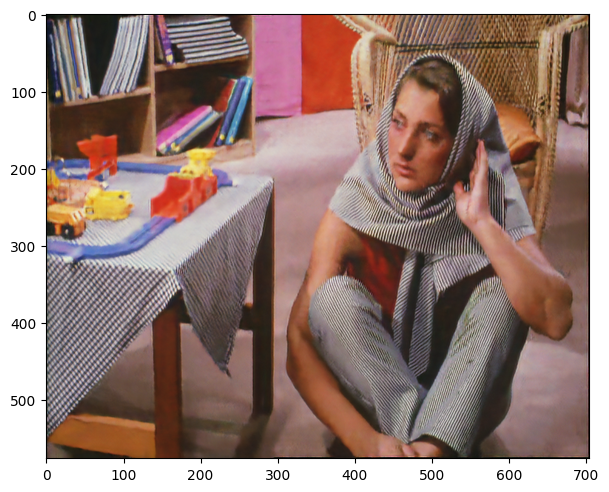

Iteration 03400    Loss 0.009918   PSNR_noisy: 20.035798   PSRN_gt: 28.277843 PSNR_gt_sm: 30.399194

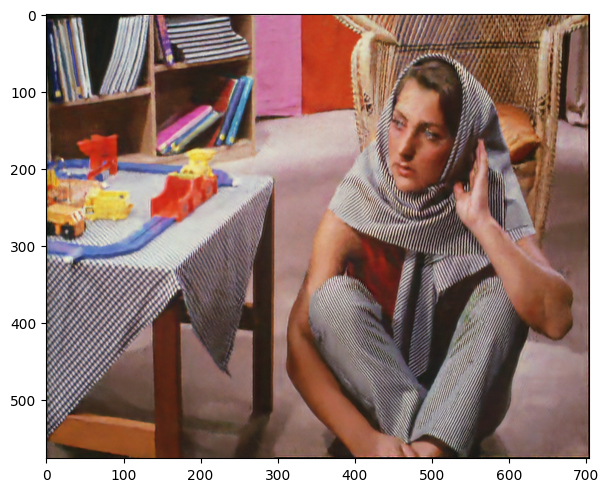

Iteration 03500    Loss 0.009808   PSNR_noisy: 20.084076   PSRN_gt: 28.511743 PSNR_gt_sm: 30.449383

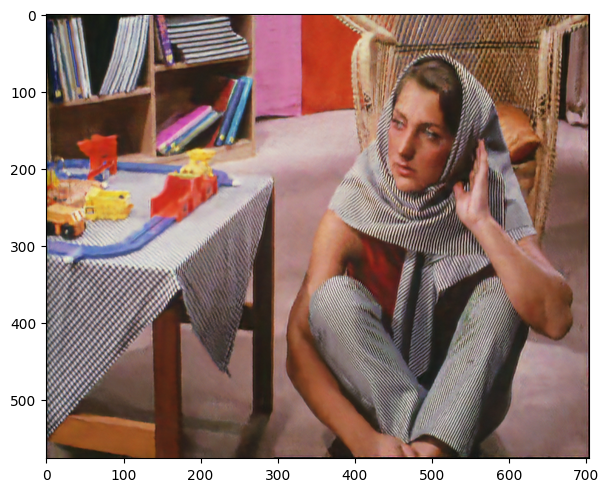

Iteration 03600    Loss 0.009746   PSNR_noisy: 20.111695   PSRN_gt: 28.548655 PSNR_gt_sm: 30.486021

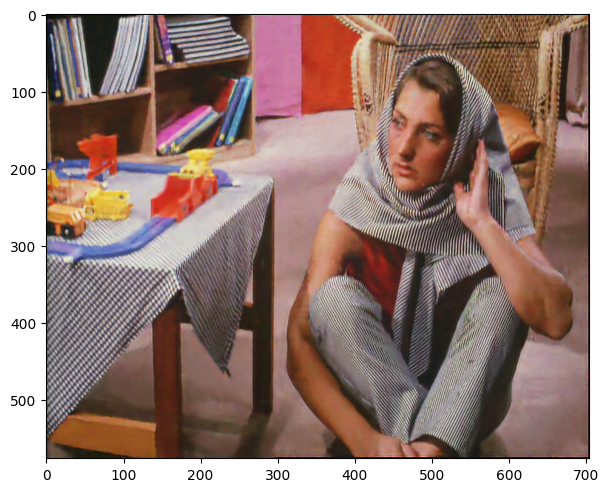

Iteration 03700    Loss 0.009775   PSNR_noisy: 20.098992   PSRN_gt: 28.261299 PSNR_gt_sm: 30.511914

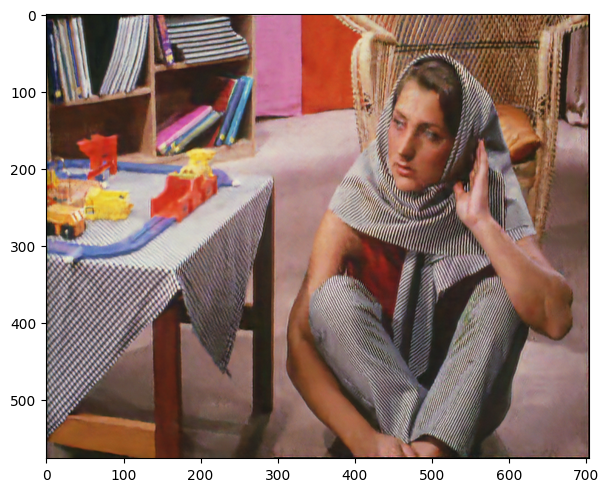

Iteration 03800    Loss 0.009687   PSNR_noisy: 20.138235   PSRN_gt: 28.464621 PSNR_gt_sm: 30.540445

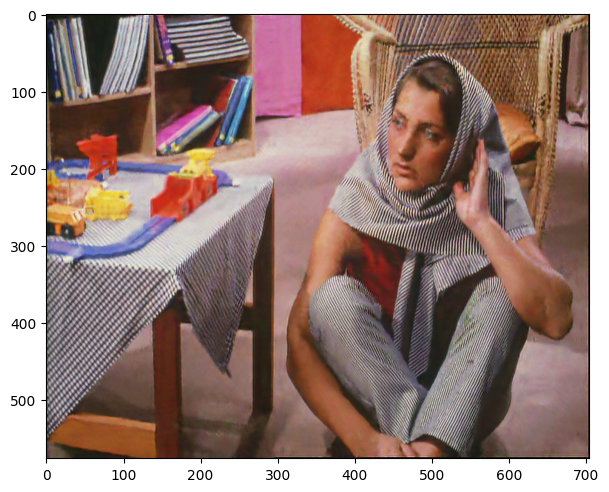

Iteration 03900    Loss 0.009580   PSNR_noisy: 20.186352   PSRN_gt: 28.627663 PSNR_gt_sm: 30.553917

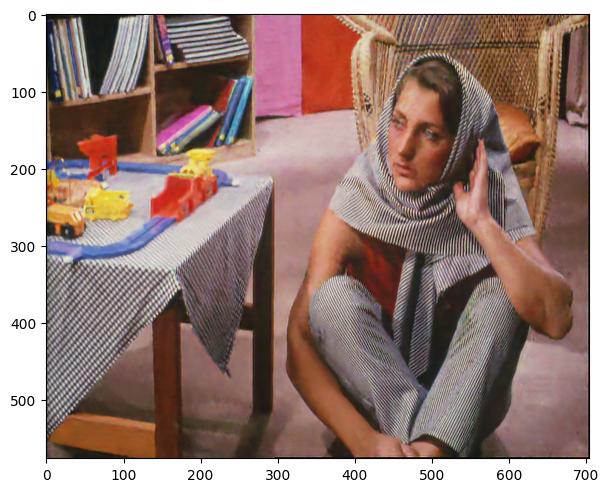

Iteration 04000    Loss 0.009561   PSNR_noisy: 20.195003   PSRN_gt: 28.592194 PSNR_gt_sm: 30.565313

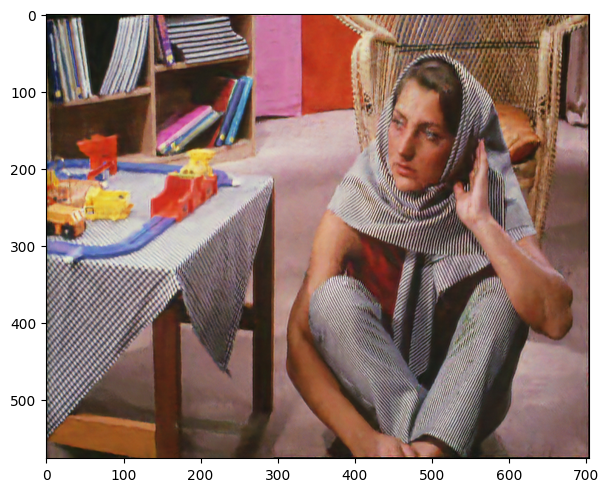

Iteration 04100    Loss 0.009501   PSNR_noisy: 20.222500   PSRN_gt: 28.553733 PSNR_gt_sm: 30.568947

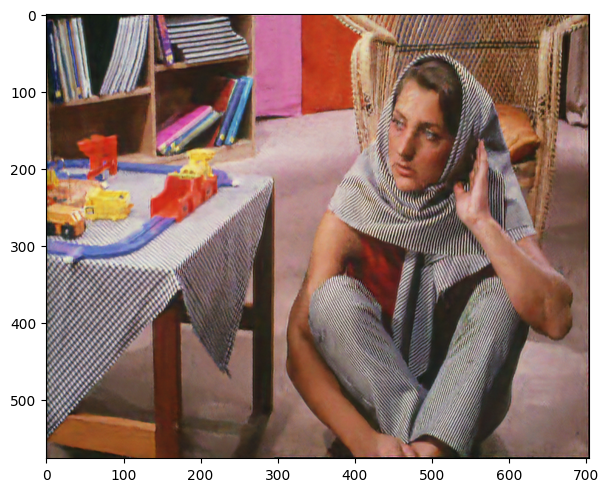

Iteration 04200    Loss 0.009461   PSNR_noisy: 20.240732   PSRN_gt: 28.576747 PSNR_gt_sm: 30.562681

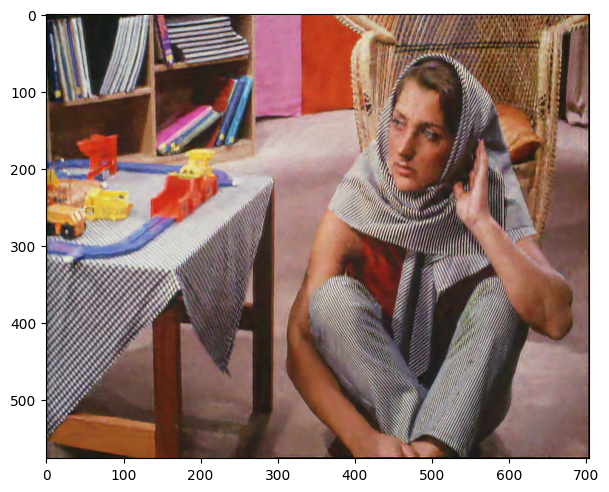

Iteration 04300    Loss 0.009460   PSNR_noisy: 20.241280   PSRN_gt: 28.471041 PSNR_gt_sm: 30.549837

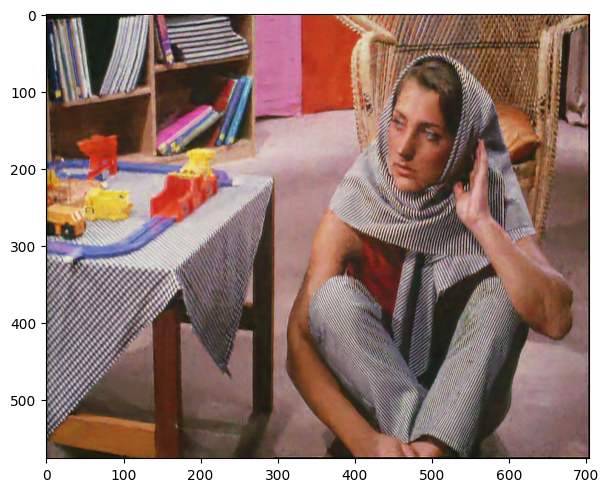

Iteration 04400    Loss 0.009397   PSNR_noisy: 20.270058   PSRN_gt: 28.545878 PSNR_gt_sm: 30.535749

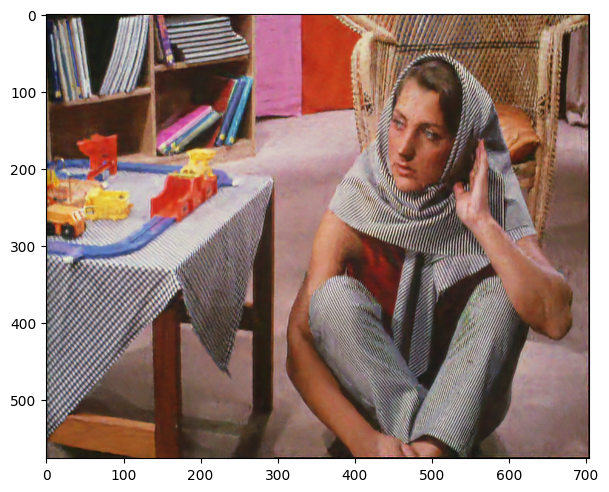

Iteration 04500    Loss 0.009322   PSNR_noisy: 20.305031   PSRN_gt: 28.498584 PSNR_gt_sm: 30.504634

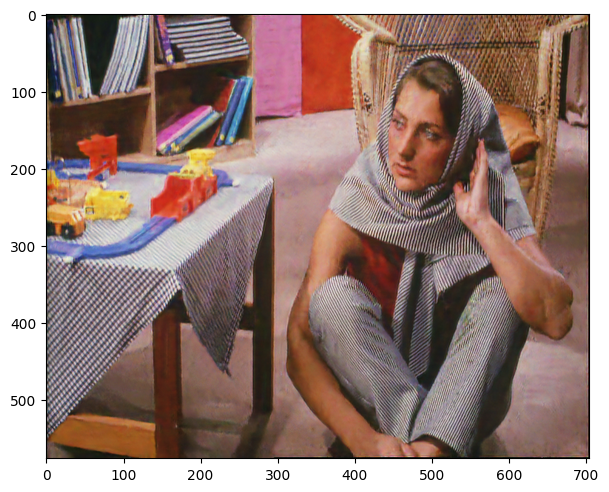

Iteration 04600    Loss 0.009308   PSNR_noisy: 20.311634   PSRN_gt: 28.410663 PSNR_gt_sm: 30.477002

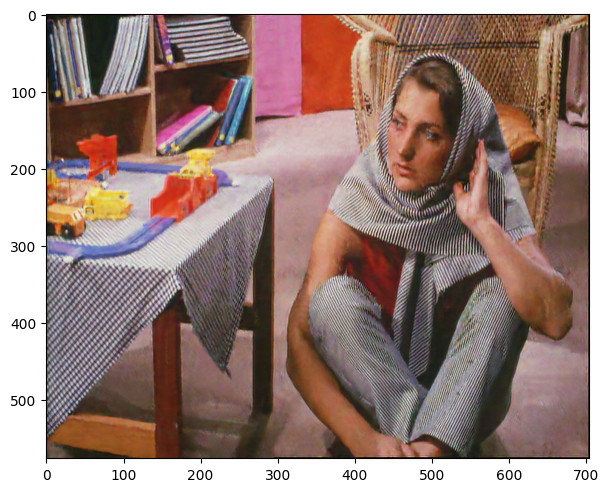

Iteration 04700    Loss 0.009281   PSNR_noisy: 20.324176   PSRN_gt: 28.365688 PSNR_gt_sm: 30.434160

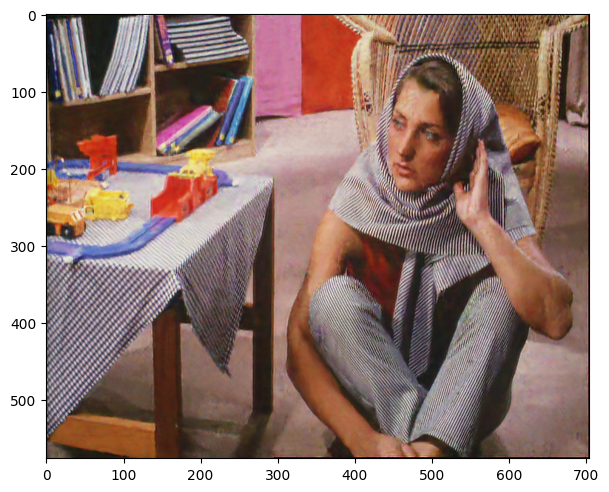

Iteration 04800    Loss 0.009166   PSNR_noisy: 20.378195   PSRN_gt: 28.469224 PSNR_gt_sm: 30.391057

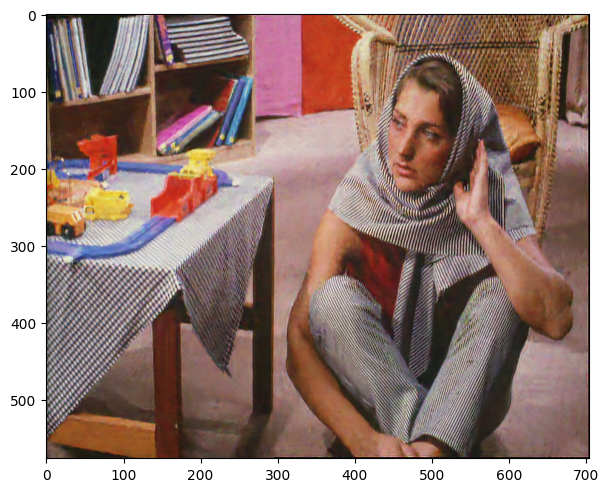

Iteration 04900    Loss 0.009287   PSNR_noisy: 20.321098   PSRN_gt: 28.044998 PSNR_gt_sm: 30.338287

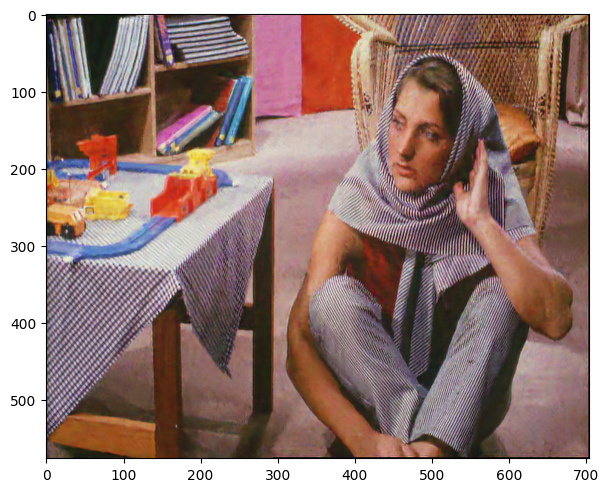

Iteration 05000    Loss 0.009190   PSNR_noisy: 20.366717   PSRN_gt: 28.122799 PSNR_gt_sm: 30.290625

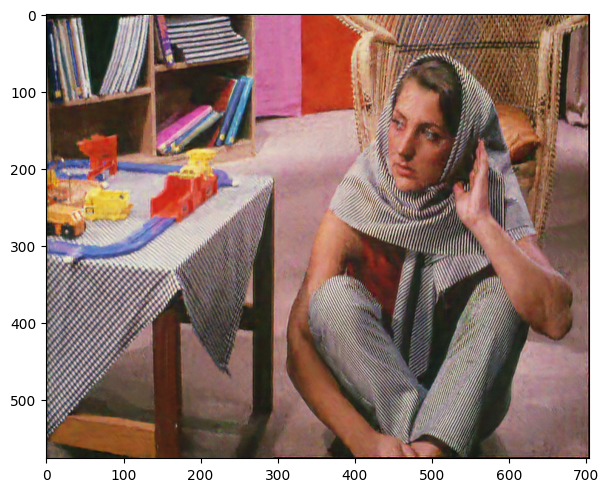

Iteration 05100    Loss 0.009158   PSNR_noisy: 20.382084   PSRN_gt: 28.031975 PSNR_gt_sm: 30.227863

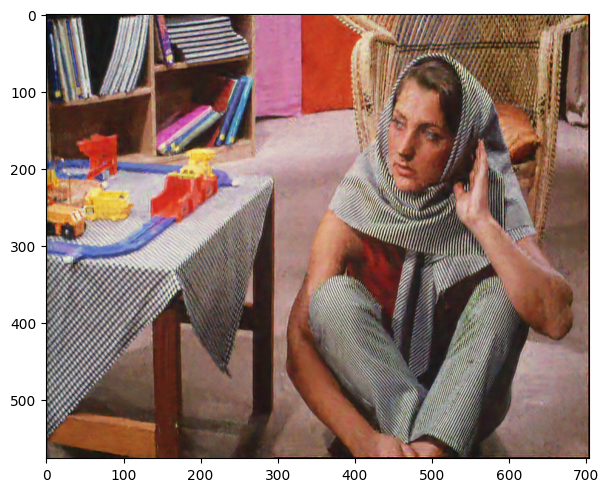

Iteration 05200    Loss 0.009040   PSNR_noisy: 20.438525   PSRN_gt: 28.231509 PSNR_gt_sm: 30.176463

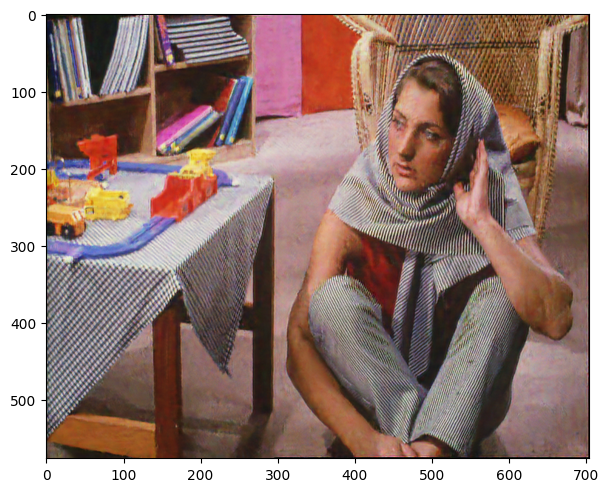

Iteration 05300    Loss 0.008957   PSNR_noisy: 20.478235   PSRN_gt: 28.160575 PSNR_gt_sm: 30.114067

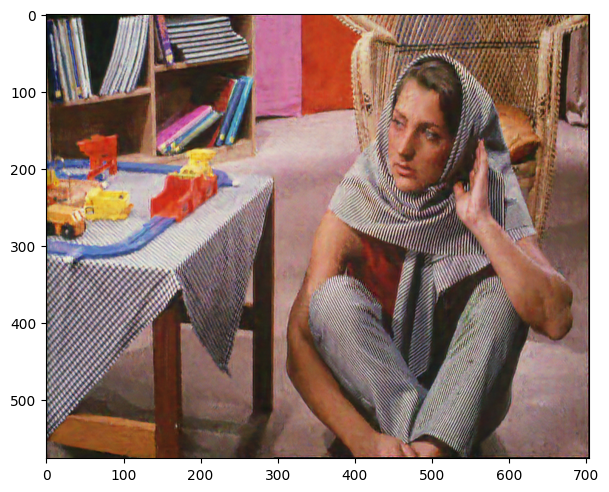

Iteration 05400    Loss 0.008981   PSNR_noisy: 20.466942   PSRN_gt: 27.998093 PSNR_gt_sm: 30.038192

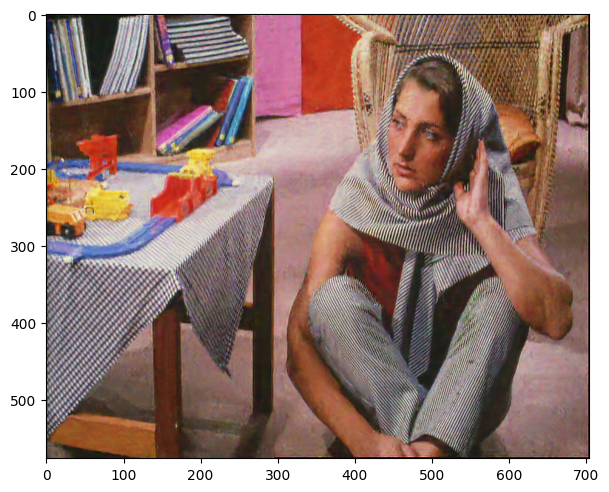

Iteration 05500    Loss 0.008955   PSNR_noisy: 20.479251   PSRN_gt: 27.912061 PSNR_gt_sm: 29.959425

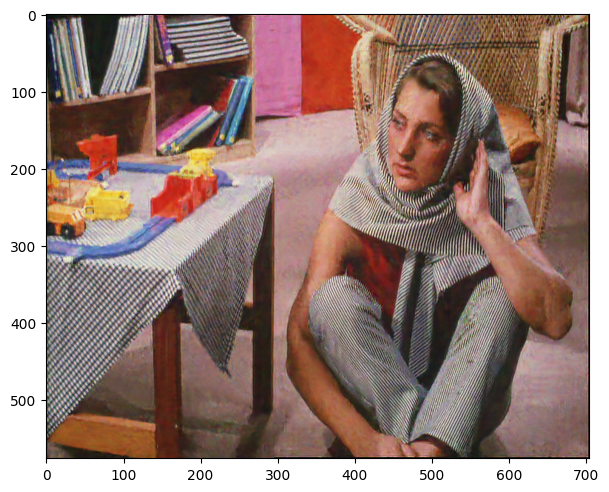

Iteration 05600    Loss 0.008934   PSNR_noisy: 20.489415   PSRN_gt: 27.819576 PSNR_gt_sm: 29.898425

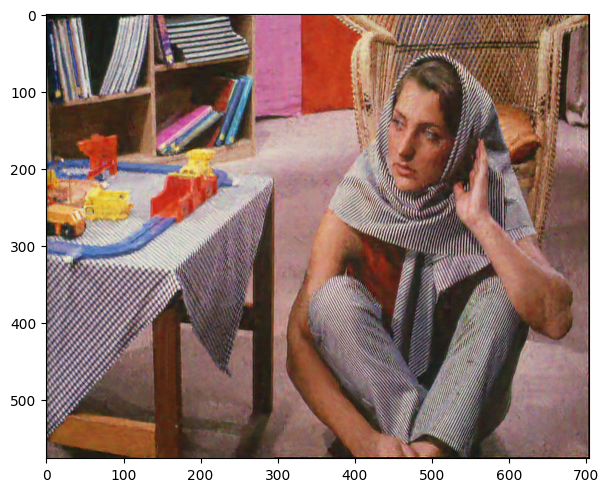

Iteration 05700    Loss 0.008890   PSNR_noisy: 20.510976   PSRN_gt: 27.863542 PSNR_gt_sm: 29.822750

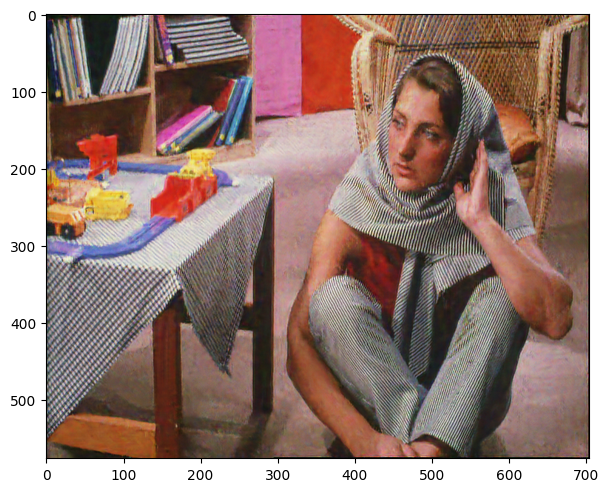

Iteration 05800    Loss 0.008787   PSNR_noisy: 20.561396   PSRN_gt: 27.831207 PSNR_gt_sm: 29.747446

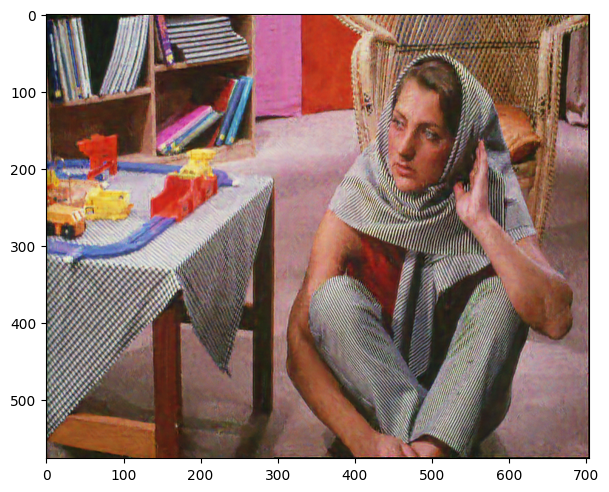

Iteration 05900    Loss 0.008755   PSNR_noisy: 20.577302   PSRN_gt: 27.740033 PSNR_gt_sm: 29.668963

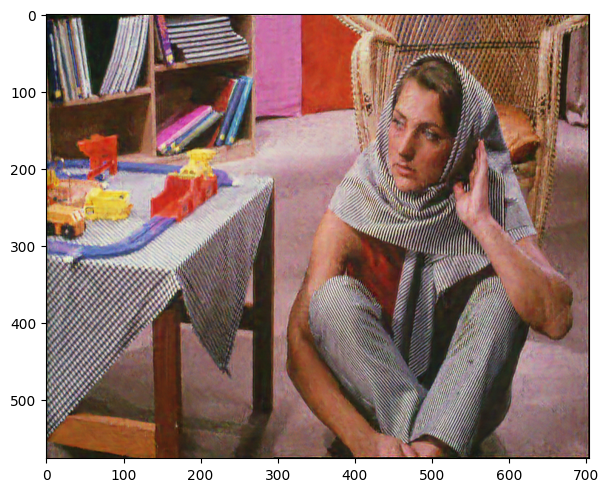

Iteration 05999    Loss 0.008728   PSNR_noisy: 20.590818   PSRN_gt: 27.782190 PSNR_gt_sm: 29.593544

In [8]:
net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()
out_avg = None
last_net = None
psrn_noisy_last = 0

i = 0
def closure():
    
    global i, out_avg, psrn_noisy_last, last_net, net_input
    
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)
    
    out = net(net_input)
    
    # Smoothing
    if out_avg is None:
        out_avg = out.detach()
    else:
        out_avg = out_avg * exp_weight + out.detach() * (1 - exp_weight)
            
    total_loss = mse(out, img_noisy_torch)
    total_loss.backward()
        
    
    psrn_noisy = peak_signal_noise_ratio(img_noisy_np, out.detach().cpu().numpy()[0]) 
    psrn_gt    = peak_signal_noise_ratio(img_np, out.detach().cpu().numpy()[0]) 
    psrn_gt_sm = peak_signal_noise_ratio(img_np, out_avg.detach().cpu().numpy()[0]) 
    
    # Note that we do not have GT for the "snail" example
    # So 'PSRN_gt', 'PSNR_gt_sm' make no sense
    print ('\rIteration %05d    Loss %f   PSNR_noisy: %f   PSRN_gt: %f PSNR_gt_sm: %f' % (i, total_loss.item(), psrn_noisy, psrn_gt, psrn_gt_sm), end='')
    if  PLOT and i % show_every == 0:
        out_np = torch_to_np(out)
        plot_image_grid([np.clip(out_np, 0, 1)], factor=figsize, nrow=1)

        list_out_np.append(out_np)
        
    
    # Backtracking
    if i % show_every:
        if psrn_noisy - psrn_noisy_last < -5: 
            print('Falling back to previous checkpoint.')

            for new_param, net_param in zip(last_net, net.parameters()):
                net_param.data.copy_(new_param.cuda())

            return total_loss*0
        else:
            last_net = [x.detach().cpu() for x in net.parameters()]
            psrn_noisy_last = psrn_noisy
            
    i += 1

    return total_loss

p = get_params(OPT_OVER, net, net_input)
optimize(OPTIMIZER, p, closure, LR, num_iter)

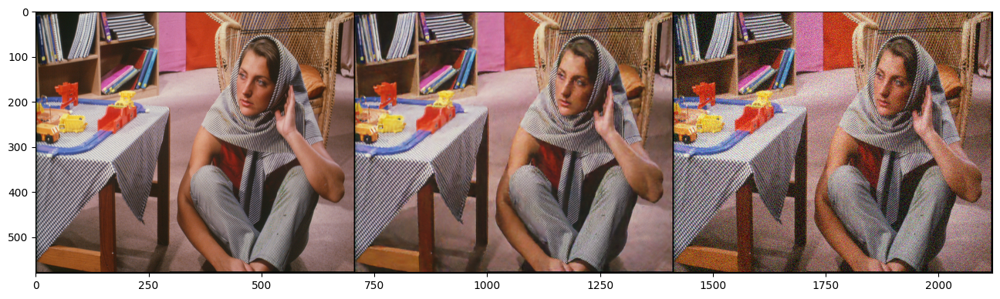

In [7]:
out_np = torch_to_np(net(net_input))
q = plot_image_grid([ img_np, np.clip(out_np, 0, 1), img_noisy_np], factor=13);

In [11]:
from scipy.io import savemat
savemat('/content/outputs.mat', {'REF': img_np, 'DET': img_noisy_np, 'outputs': list_out_np})